<a href="https://colab.research.google.com/github/zhshao98/Master-thesis-online-LDA-with-sparse-update/blob/main/master_thesis_code_zehao.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import sys
sys.path.append('/content/gdrive/MyDrive/onlineldavb_sparse')

In [ ]:
import  string, numpy, getopt, sys, random, time, re, pprint, urllib.request
    #cPickle

import onlineldavb
import wikirandom

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
%pip install pickle5

     |████████████████████████████████| 256 kB 8.4 MB/s 


In [ ]:
import pickle5 as pickle

In [ ]:
vocab = open('/content/gdrive/MyDrive/onlineldavb_sparse/dictnostops.txt',"r").readlines()
W = len(vocab)

In [ ]:
vocab[1]

'yellow\n'

Download Wikipedia documents and save them in pickle files. We can skip this part after we downloaded all documents.

In [ ]:

for i in range(1000):
  
  (t1, t2) = wikirandom.get_random_wikipedia_article()
  docset_all.append(t1)
  articlenames_all.append(t2)
  if i%10 == 0:
    print(i)



downloaded Phaonia_apicata. parsing...
0
downloaded Danny_Patrick_(director). parsing...
downloaded Gaspard_Cuenot. parsing...
downloaded American_Way_(magazine). parsing...
downloaded Parabolic_microphone. parsing...
downloaded Astraeus_odoratus. parsing...
downloaded Mandatory_Brunch_Meeting. parsing...
downloaded Riverdale_station_(Illinois). parsing...
downloaded National_Register_of_Historic_Places_listings_in_West_Virginia. parsing...
downloaded 1987_World_Championships_in_Athletics_%E2%80%93_Men%27s_hammer_throw. parsing...
downloaded M%C4%81oriness. parsing...
10
downloaded 1910%E2%80%9311_Iowa_State_Cyclones_men%27s_basketball_team. parsing...
downloaded Toy_Gun_Films. parsing...
downloaded Berainak. parsing...
downloaded Shep_(Thanhouser_Collie). parsing...
downloaded Sunset_Hospital. parsing...
downloaded Andr%C3%A9s_Ayala_(footballer,_born_2000). parsing...
downloaded I%27m_on_My_Way_(The_Proclaimers_song). parsing...
downloaded List_of_OMB_Circulars_and_Bulletins. parsing.

SystemExit: ignored

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2890: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [ ]:
with open('/content/gdrive/MyDrive/onlineldavb_sparse/docset_all.pkl', 'wb') as f:
   pickle.dump(docset_all, f)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/articlenames_all.pkl', 'wb') as f:
   pickle.dump(articlenames_all, f)


Load 10208 Wikipedia documents.

In [ ]:
with open('/content/gdrive/MyDrive/onlineldavb_sparse/docset_all.pkl', "rb") as fh:
  docset_all = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/articlenames_all.pkl', "rb") as fh:
  articlenames_all = pickle.load(fh)


In [ ]:
len(docset_all)

10208

In [ ]:
docset_all[0]

" USCIS Form N-400, Application for Naturalization (2016 revision)  '''Form N-400''' is used to apply for US citizenship through the naturalization process. Lawful permanent residents (also known as green card holders) of the United States, who meet the eligibility requirements, can file N-400 form to request citizenship. In the United States, 8.8 million Lawful Permanent Residents are eligible to naturalize.  Becoming an American citizen gives the same rights and privileges of citizenship as natural born American citizens, except one: naturalized U.S. citizens are not eligible for the Office of the President or Vice President of the United States.  ==US citizenship eligibility requirements== To be able to apply for citizenship through naturalization, you have to meet the following requirements. You must: * Be 18 years of age or above. * Be a lawful permanent resident for 5 years (3 years if married to a US citizen). * Have maintained continuous residence during the past 5 years (3 yea

# Fixed corpus of 10208 documents  from Wikipedia. 
We set aside a 100-document test set and a separate
100-document validation set. 

In [ ]:

# The total number of documents in Wikipedia
docset_train = docset_all[0:-200]
docset_val = docset_all[-200:-100]
docset_test = docset_all[-100:]
articlenames_train = articlenames_all[0:-200]
articlenames_val = articlenames_all[-200:-100]
articlenames_test = articlenames_all[-100:]
D = len(docset_train)

In [ ]:
len(docset_test)

100

## The function to do experiments:

In [ ]:
 
def do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa, track=False,track_test=False,testset=None):
  '''
  Input: 
  batchsize, K, D, alpha, eta, tau_0, kappa, 
  track: whether we should track the perplexity on each mini-batch in each iteration
  track_test: whether we should track the perplexity on the test set
  testset: The test set used to track the perplexity

  Output:
  olda without sparse update, olda with sparse update,
  (if track is True), perplexity on the newest training batch in all iterations (with and without sparse update) 
  (if track_test is True), perplexity on the test set in all iterations (with and without sparse update)
  '''
  
  documentstoanalyze = int(D/batchsize)
  param = [batchsize,tau_0,kappa,alpha,eta]
  per_est = []
  per_est_s = []
  per_est_test = []
  per_est_test_s = []

    # Our vocabulary
  #vocab = open('/content/gdrive/MyDrive/onlineldavb_sparse/dictnostops.txt',"r").readlines()
  #W = len(vocab)

    # Initialize the algorithm with alpha=1/K, eta=1/K, tau_0=1024, kappa=0.7
  olda = onlineldavb.OnlineLDA_sparse(vocab, K, D, alpha, eta, tau_0,kappa,False)
  olda_s = onlineldavb.OnlineLDA_sparse(vocab, K, D, alpha, eta, tau_0,kappa,True)
    # Run until we've seen D documents. (Feel free to interrupt *much*
    # sooner than this.)
  for iteration in range(0, documentstoanalyze):
        # Display iterations:
        
        # Download some articles
        docset = docset_train[iteration*batchsize:(iteration+1)*batchsize]
        articlenames = articlenames_train[iteration*batchsize:(iteration+1)*batchsize]
        #(docset, articlenames) = \
        #    wikirandom.get_random_wikipedia_articles(batchsize)
        #docset = list()
        #articlenames = list()
        #for b in range(batchsize):
        #    (docset_temp, name_temp) = wikirandom.get_random_wikipedia_article()
        #    docset.append(docset_temp)
        #    articlenames.append(name_temp)
        # Give them to online LDA
        (gamma, bound) = olda.update_lambda_docs(docset)
        (gamma_s, bound_s) = olda_s.update_lambda_docs(docset)
        # Compute an estimate of held-out perplexity
        if track == True:
          (wordids, wordcts) = onlineldavb.parse_doc_list(docset, olda._vocab)
          (wordids_s, wordcts_s) = onlineldavb.parse_doc_list(docset, olda_s._vocab)
          perwordbound = bound * len(docset) / (D * sum(map(sum, wordcts)))
          perwordbound_s = bound_s * len(docset) / (D * sum(map(sum, wordcts_s)))
          #print (f'{iteration}:  rho_t = {olda._rhot},  held-out perplexity estimate = {numpy.exp(-perwordbound)}')
          #print (f'{iteration}:  rho_t_s = {olda_s._rhot},  held-out perplexity estimate_s = {numpy.exp(-perwordbound_s)}')
          per_est.append(numpy.exp(-perwordbound))
          per_est_s.append(numpy.exp(-perwordbound_s))
          if iteration%10 == 0:
            print(f'{iteration}:track is done')
        if track_test == True:
          
          lambda_now = olda._lambda
          lambda_now_s = olda_s._lambda
          (gamma_t, _) = olda.do_e_step_docs(testset) # compute gamma for the test set
          (gamma_t_s, _) = olda_s.do_e_step_docs(testset)
          (wordids, wordcts) = onlineldavb.parse_doc_list(testset, olda._vocab)
          (wordids_s, wordcts_s) = onlineldavb.parse_doc_list(testset, olda_s._vocab)
          bound_test = olda.approx_bound_docs_lambda(testset, gamma_t,lambda_now) # compute approximate bound of perplexity for the test set
          bound_test_s = olda_s.approx_bound_docs_lambda(testset, gamma_t_s,lambda_now_s)
          perwordbound = bound_test * len(testset) / (D * sum(map(sum, wordcts)))
          perwordbound_s = bound_test_s * len(testset) / (D * sum(map(sum, wordcts_s)))
          #print (f'{iteration}:  rho_t = {olda._rhot},  held-out perplexity estimate = {numpy.exp(-perwordbound)}')
          #print (f'{iteration}:  rho_t_s = {olda_s._rhot},  held-out perplexity estimate_s = {numpy.exp(-perwordbound_s)}')
          per_est_test.append(numpy.exp(-perwordbound))
          per_est_test_s.append(numpy.exp(-perwordbound_s))
          if iteration%10 == 0:
            print(f'{iteration}:track_test is done')

        #, % \
         #   (iteration, olda._rhot, numpy.exp(-perwordbound))

        # Save lambda, the parameters to the variational distributions
        # over topics, and gamma, the parameters to the variational
        # distributions over topic weights for the articles analyzed in
        # the last iteration.
        #if (iteration % 10 == 0):
        #    numpy.savetxt('lambda-%d.dat' % iteration, olda._lambda)
        #    numpy.savetxt('gamma-%d.dat' % iteration, gamma)
        #    numpy.savetxt('lambda_s-%d.dat' % iteration, olda_s._lambda)
        #    numpy.savetxt('gamma_s-%d.dat' % iteration, gamma_s)


  if ((track==True) and (track_test==True)):
      print("True, True")
      return olda,olda_s, per_est, per_est_s,per_est_test,per_est_test_s
  elif ((track==True) and (track_test==False)):
      print("True, False")
      return olda,olda_s, per_est, per_est_s
  elif ((track_test==True) and (track==False)):
      print("False, True")
      return olda,olda_s, per_est_test,per_est_test_s
  else:
      print("False,False")
      return olda,olda_s
        

# Study learning parameters: Batchsize， kappa, tau_0

batchsize in {4,16,64,256,1024}; kappa in {0.5,0.6,0.7,0.8}, tau_0 in {16.64.256,1024}

In [ ]:
# The number of documents to analyze each iteration
#batchsize = 1024

# The number of topics
K = 100
alpha=1/K
eta=1/K
#tau_0 = 256
#kappa = 0.5

In [ ]:
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed.pkl', "rb") as fh:
  lambda_fixed = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_s.pkl', "rb") as fh:
  lambda_fixed_s = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/params_list.pkl', "rb") as fh:
  params_list = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test.pkl', "rb") as fh:
  perplexity_test = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_s.pkl', "rb") as fh:
  perplexity_test_s = pickle.load(fh)

In [ ]:
len(params_list)

80

In [ ]:
min(perplexity_test_s[64:])

1869.380082754326

Run experiments. Save lambda by the model and perplexity on the test set ( with and without sparse update).

In [ ]:
batchsizes = [4, 16, 64, 256, 1024]
kappas = [0.5,0.6,0.7,0.8]
taus = [16, 64, 256, 1024]

#params_list = []
#lambda_fixed = []
#lambda_fixed_s = []
#perplexity_test = []
#perplexity_test_s = []
#perplexity_all = []
#perplexity_all_s = []

for batchsize in batchsizes:

  for kappa in kappas:
    for tau_0 in taus:
      param = [batchsize,alpha,eta,tau_0,kappa]
      if param in params_list:
        continue
      #olda_fit, olda_fit_s, perplexity_fit,perplexity_fit_s = do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa,False)
      olda_fit, olda_fit_s = do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa)
      #perplexity_all.append(perplexity_fit)
      #perplexity_all_s.append(perplexity_fit_s)

      # perplexity on test set: without sparse update
      lambda_fixed.append(olda_fit._lambda)    
      (gamma_test, bound_temp) = olda_fit.update_lambda_docs(docset_test)
      bound_test = olda_fit.approx_bound_docs_lambda(docset_test, gamma_test,lambda_fixed[-1])
      (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda_fit._vocab)
      perwordbound_test = bound_test * len(docset_test) / (D * sum(map(sum, wordcts)))
      perplexity_test.append(numpy.exp(-perwordbound_test))

      # perplexity on test set: with sparse update
      lambda_fixed_s.append(olda_fit_s._lambda)    
      (gamma_test_s, bound_temp) = olda_fit_s.update_lambda_docs(docset_test)
      bound_test_s = olda_fit_s.approx_bound_docs_lambda(docset_test, gamma_test_s,lambda_fixed_s[-1])
      (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda_fit_s._vocab)
      perwordbound_test_s = bound_test_s * len(docset_test) / (D * sum(map(sum, wordcts)))
      perplexity_test_s.append(numpy.exp(-perwordbound_test_s))

      params_list.append(param)


      with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed.pkl', 'wb') as f:
        pickle.dump(lambda_fixed, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_s.pkl', 'wb') as f:
        pickle.dump(lambda_fixed_s, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test.pkl', 'wb') as f:
        pickle.dump(perplexity_test, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_s.pkl', 'wb') as f:
        pickle.dump(perplexity_test_s, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/params_list.pkl', 'wb') as f:
        pickle.dump(params_list, f)
      
  


流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.28851435e+01]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [6.99968482e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.95405153e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

# To find the best learning parameters, compare perplexity on the test set.

In [ ]:
print(numpy.argmin(perplexity_test_s[0:16]))
print(params_list[6])
print(perplexity_test_s[6],perplexity_test[6])
print(numpy.argmin(perplexity_test_s[16:32]))
print(params_list[17])
print(perplexity_test_s[17],perplexity_test[17])
print(numpy.argmin(perplexity_test_s[32:48]))
print(params_list[32])
print(perplexity_test_s[32],perplexity_test[32])
print(numpy.argmin(perplexity_test_s[48:64]))
print(params_list[48])
print(perplexity_test_s[48],perplexity_test[48])
print(numpy.argmin(perplexity_test_s[64:80]))
print(params_list[74])
print(perplexity_test_s[74],perplexity_test[74])
#print(numpy.mean(perplexity_test_s[0:16]),numpy.mean(perplexity_test_s[16:32]),numpy.mean(perplexity_test_s[32:48]),numpy.mean(perplexity_test_s[48:]))

6
[16, 0.01, 0.01, 256, 0.6]
1749.0897726232984 1804.6087502605315
1
[64, 0.01, 0.01, 64, 0.5]
1601.2833023773114 1560.1491868836997
0
[256, 0.01, 0.01, 16, 0.5]
1301.0362378134225 1321.8576848057126
0
[1024, 0.01, 0.01, 16, 0.5]
2005.517083479674 2003.5930736031503
10
[4, 0.01, 0.01, 256, 0.7]
1869.380082754326 1878.206066378699


Find the best learning parmaeters: [256, 0.01, 0.01, 16, 0.5].



In [ ]:
param_best = [256, 0.01, 0.01, 16, 0.5]
kappa_best = 0.5
tau_best = 16
batchsize_best = 256
alpha = 0.01
eta = 0.01

Track the perplexity on test set and on each mini-batch with respect to iterations.

In [ ]:
result_test_new = do_experiments_1(batchsize_best,K,D,alpha,eta,tau_best,kappa_best,track=True,track_test=True,testset=docset_test)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/result_test_new.pkl', 'wb') as f:
   pickle.dump(result_test_new, f)
result_valid_new = do_experiments_1(batchsize_best,K,D,alpha,eta,tau_best,kappa_best,track=True,track_test=True,testset=docset_val)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/result_valid_new.pkl', 'wb') as f:
   pickle.dump(result_valid_new, f)

流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.75410206e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [8.37248400e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



流式输出内容被截断，只能显示最后 5000 行内容。
 [0.01531988]
 [0.06182395]
 [0.01      ]
 [0.01428418]
 [0.03857308]
 [0.01      ]
 [0.01000254]
 [0.01726481]
 [0.36068611]
 [1.28863152]
 [0.01      ]
 [2.64074484]
 [0.03814778]
 [0.01      ]
 [0.01000012]
 [0.0615562 ]
 [0.01190939]
 [0.01      ]
 [0.0399042 ]
 [1.00996944]
 [0.0104527 ]
 [0.01      ]
 [0.01      ]
 [0.01      ]
 [0.01      ]
 [0.01168052]
 [0.05387206]
 [0.09467724]
 [0.04391854]
 [0.01674212]
 [0.01      ]
 [0.23966443]
 [0.01      ]
 [0.01150237]
 [0.01      ]
 [0.01      ]
 [0.0118139 ]
 [0.01      ]
 [0.01      ]
 [0.01      ]
 [0.36038246]
 [0.01      ]
 [0.02202822]
 [0.91221044]
 [0.01042309]
 [1.26660082]
 [0.46210503]
 [0.01764336]
 [0.01      ]
 [0.64798233]
 [0.04478525]
 [0.01061272]
 [0.07064799]
 [0.01      ]
 [0.01915627]
 [0.09589029]
 [0.28575324]
 [0.01      ]
 [0.01      ]
 [0.01      ]
 [0.05388349]
 [0.25655171]
 [0.01      ]
 [0.02566538]
 [0.02810815]
 [0.01567674]
 [0.01      ]
 [0.02191562]
 [0.01      ]
 [0.01 

# perplexity on each mini-batch

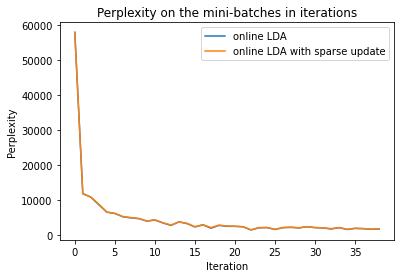

In [ ]:
plt.plot(result_valid_new[-4],label="online LDA")
plt.plot(result_valid_new[-3],label="online LDA with sparse update")
plt.legend()
plt.xlabel("Iteration")
plt.ylabel("Perplexity")
plt.title("Perplexity on the mini-batches in iterations")
plt.show()

# perplexity on the validation set

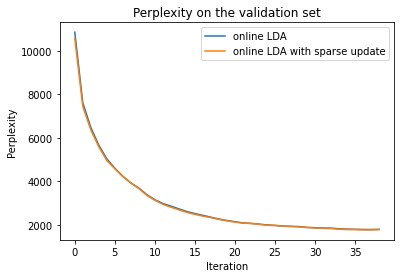

In [ ]:
plt.plot(result_valid_new[-2],label="online LDA")
plt.plot(result_valid_new[-1],label="online LDA with sparse update")
plt.legend()
plt.xlabel("Iteration")
plt.ylabel("Perplexity")
plt.title("Perplexity on the validation set")
plt.show()

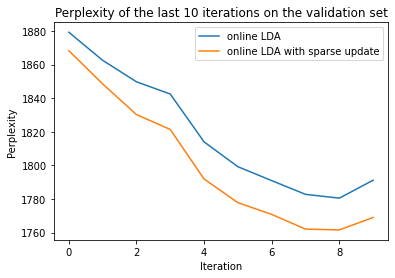

In [ ]:
plt.plot(result_valid_new[-2][-10:],label="online LDA")
plt.plot(result_valid_new[-1][-10:],label="online LDA with sparse update")
plt.legend()
plt.xlabel("Iteration")
plt.ylabel("Perplexity")
plt.title("Perplexity of the last 10 iterations on the validation set")
plt.show()

# Hyperparameters:eta and alpha.

Fix alpha=0.01, etas=[0.01,0.02,0.05,0.1,0.2].    
Fix eta=0.01, alphas = [0.01,0.02,0.05,0.1,0.2].


In [ ]:
K = 100

tau_0 = 16
batchsize = 256
kappa = 0.5


In [ ]:
params_list_hyper = []
lambda_fixed_hyper = []
lambda_fixed_s_hyper = []
perplexity_test_hyper = []
perplexity_test_s_hyper = []

In [ ]:

alpha=0.01
etas=[0.01,0.02,0.05,0.1,0.2]
for eta in etas:
      param = [batchsize,alpha,eta,tau_0,kappa]
      if param in params_list_hyper:
        continue
      #olda_fit, olda_fit_s, perplexity_fit,perplexity_fit_s = do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa,False)
      olda_fit, olda_fit_s = do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa)
      #perplexity_all.append(perplexity_fit)
      #perplexity_all_s.append(perplexity_fit_s)

      # perplexity on test set: without sparse update
      lambda_fixed_hyper.append(olda_fit._lambda)    
      (gamma_test, bound_temp) = olda_fit.update_lambda_docs(docset_test)
      bound_test = olda_fit.approx_bound_docs_lambda(docset_test, gamma_test,lambda_fixed_hyper[-1])
      (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda_fit._vocab)
      perwordbound_test = bound_test * len(docset_test) / (D * sum(map(sum, wordcts)))
      perplexity_test_hyper.append(numpy.exp(-perwordbound_test))

      # perplexity on test set: with sparse update
      lambda_fixed_s_hyper.append(olda_fit_s._lambda)    
      (gamma_test_s, bound_temp) = olda_fit_s.update_lambda_docs(docset_test)
      bound_test_s = olda_fit_s.approx_bound_docs_lambda(docset_test, gamma_test_s,lambda_fixed_s_hyper[-1])
      (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda_fit_s._vocab)
      perwordbound_test_s = bound_test_s * len(docset_test) / (D * sum(map(sum, wordcts)))
      perplexity_test_s_hyper.append(numpy.exp(-perwordbound_test_s))

      params_list_hyper.append(param)

      with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_hyper.pkl', 'wb') as f:
        pickle.dump(lambda_fixed_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_s_hyper.pkl', 'wb') as f:
        pickle.dump(lambda_fixed_s_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_hyper.pkl', 'wb') as f:
        pickle.dump(perplexity_test_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_s_hyper.pkl', 'wb') as f:
        pickle.dump(perplexity_test_s_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/params_list_hyper.pkl', 'wb') as f:
        pickle.dump(params_list_hyper, f)


流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.20111503e+01]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [3.85010397e+01]
 [2.16888600e+01]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [9.70200551e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [6.94306957e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

In [ ]:
eta=0.01
alphas=[0.01,0.02,0.05,0.1,0.2]
for alpha in alphas:
      param = [batchsize,alpha,eta,tau_0,kappa]
      if param in params_list_hyper:
        continue
      #olda_fit, olda_fit_s, perplexity_fit,perplexity_fit_s = do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa,False)
      olda_fit, olda_fit_s = do_experiments_1(batchsize,K, D, alpha,eta, tau_0, kappa)
      #perplexity_all.append(perplexity_fit)
      #perplexity_all_s.append(perplexity_fit_s)

      # perplexity on test set: without sparse update
      lambda_fixed_hyper.append(olda_fit._lambda)    
      (gamma_test, bound_temp) = olda_fit.update_lambda_docs(docset_test)
      bound_test = olda_fit.approx_bound_docs_lambda(docset_test, gamma_test,lambda_fixed_hyper[-1])
      (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda_fit._vocab)
      perwordbound_test = bound_test * len(docset_test) / (D * sum(map(sum, wordcts)))
      perplexity_test_hyper.append(numpy.exp(-perwordbound_test))

      # perplexity on test set: with sparse update
      lambda_fixed_s_hyper.append(olda_fit_s._lambda)    
      (gamma_test_s, bound_temp) = olda_fit_s.update_lambda_docs(docset_test)
      bound_test_s = olda_fit_s.approx_bound_docs_lambda(docset_test, gamma_test_s,lambda_fixed_s_hyper[-1])
      (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda_fit_s._vocab)
      perwordbound_test_s = bound_test_s * len(docset_test) / (D * sum(map(sum, wordcts)))
      perplexity_test_s_hyper.append(numpy.exp(-perwordbound_test_s))

      params_list_hyper.append(param)

      with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_hyper.pkl', 'wb') as f:
        pickle.dump(lambda_fixed_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_s_hyper.pkl', 'wb') as f:
        pickle.dump(lambda_fixed_s_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_hyper.pkl', 'wb') as f:
        pickle.dump(perplexity_test_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_s_hyper.pkl', 'wb') as f:
        pickle.dump(perplexity_test_s_hyper, f)
      with open('/content/gdrive/MyDrive/onlineldavb_sparse/params_list_hyper.pkl', 'wb') as f:
        pickle.dump(params_list_hyper, f)


流式输出内容被截断，只能显示最后 5000 行内容。
 [ 0.2024619 ]
 [ 0.20027501]
 [ 0.95342363]
 [ 0.20022569]
 [ 0.2038179 ]
 [ 0.20000185]
 [ 0.20061343]
 [ 0.20068497]
 [ 0.20449932]
 [ 0.20831664]
 [ 3.78060397]
 [ 0.2       ]
 [ 0.2       ]
 [ 0.20353177]
 [ 0.2       ]
 [ 0.20102264]
 [ 0.20255615]
 [ 0.20183373]
 [ 0.20037007]
 [ 0.20001651]
 [ 1.95118322]
 [ 0.2       ]
 [ 0.20544546]
 [ 0.20236121]
 [ 0.20144997]
 [ 0.2       ]
 [ 0.20000001]
 [ 0.20131854]
 [ 0.2006421 ]
 [ 0.21703569]
 [ 0.20000137]
 [ 0.20006924]
 [ 1.41213945]
 [ 0.2       ]
 [ 2.30814792]
 [ 0.2059055 ]
 [ 0.2       ]
 [ 0.20127297]
 [ 0.20015055]
 [ 0.2       ]
 [ 0.2       ]
 [ 1.27627094]
 [ 0.20001221]
 [ 6.7599606 ]
 [ 4.03788691]
 [ 0.20193487]
 [ 0.20112409]
 [ 0.20004592]
 [ 0.2       ]
 [ 0.2006231 ]
 [29.38404535]
 [ 0.20154795]
 [ 0.20271325]
 [ 6.20858152]
 [ 0.2       ]
 [ 0.27260586]
 [ 2.76456245]
 [ 0.20006593]
 [ 0.20087743]
 [ 0.20025834]
 [ 0.97245885]
 [ 0.20487112]
 [ 0.20127315]
 [ 0.2       ]
 [ 0.20025386

In [ ]:
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_hyper.pkl', "rb") as fh:
  lambda_fixed_hyper = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_s_hyper.pkl', "rb") as fh:
  lambda_fixed_s_hyper = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/params_list_hyper.pkl', "rb") as fh:
  params_list_hyper = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_hyper.pkl', "rb") as fh:
  perplexity_test_hyper = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/perplexity_test_s_hyper.pkl', "rb") as fh:
  perplexity_test_s_hyper = pickle.load(fh)

In [ ]:
params_list_hyper

[[256, 0.01, 0.01, 16, 0.5],
 [256, 0.01, 0.02, 16, 0.5],
 [256, 0.01, 0.05, 16, 0.5],
 [256, 0.01, 0.1, 16, 0.5],
 [256, 0.01, 0.2, 16, 0.5],
 [256, 0.02, 0.01, 16, 0.5],
 [256, 0.05, 0.01, 16, 0.5],
 [256, 0.1, 0.01, 16, 0.5],
 [256, 0.2, 0.01, 16, 0.5]]

In [ ]:
perplexity_test_s_hyper

[1300.5873434729156,
 1295.2973912098048,
 1307.714755409359,
 1324.1533151347683,
 1279.1533559299385,
 1310.7391961652852,
 1288.6447086088735,
 1331.1182856557352,
 1372.484879988065]

In [ ]:
do_experiments_1(256,0.01,0.01,16,0.5,True)

1555.1059990882507
1573.639035580874


# Unused codes

In [ ]:

with open('/content/gdrive/MyDrive/onlineldavb_sparse/params_list.pkl', "rb") as fh:
  params_list = pickle.load(fh)

In [ ]:
params_list[-1]

[1024, 0.01, 0.01, 1024, 0.8]

In [ ]:
lambda_fixed.append(olda._lambda)
lambda_fixed_s.append(olda_s._lambda)
params.append(list([alpha, eta, tau_0,kappa]))
per_est_all.append(per_est)
per_est_s_all.append(per_est_s)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed.pkl', 'wb') as f:
   pickle.dump(lambda_fixed, f)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_fixed_s.pkl', 'wb') as f:
   pickle.dump(lambda_fixed_s, f)


NameError: ignored

In [ ]:
lambda_fixed = []
lambda_fixed_s = []
params = []
per_est_all = []
per_est_s_all = []

In [ ]:
params[0]

[0.01, 0.01, 1024, 0.7]

# True Online (discard this part because documents cannot be downloaded stably)

In [ ]:
iteration_now = -1

per_est_ol = []
per_est_ol_s = []
per_est_ol_test = []
per_est_ol_test_s = []
lambda_now_ol = []
lambda_now_ol_s = []

In [ ]:
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_now_ol.pkl', 'wb') as fh:
          lambda_now_ol = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_now_ol_s.pkl', 'wb') as fh:
          lambda_now_ol_s = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/iteration_now.pkl', 'wb') as fh:
          iteration_now = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol.pkl', 'wb') as fh:
          per_est_ol = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol_s.pkl', 'wb') as fh:
          per_est_ol_s = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol_test.pkl', 'wb') as fh:
          per_est_ol_test = pickle.load(fh)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol_test_s.pkl', 'wb') as fh:
          per_est_ol_test_s = pickle.load(fh)

In [ ]:


    # The number of documents to analyze each iteration
batchsize = 256
    # The total number of documents in Wikipedia
D = 30000
    # The number of topics
K = 100
    
    # How many documents to look at
    #if (len(sys.argv) < 2):
        #documentstoanalyze = int(D/batchsize)
    #else:
        #documentstoanalyze = int(len(sys.argv[1]))
tau_0 = 16
kappa = 0.5

documentstoanalyze = int(D/batchsize)
    # Our vocabulary
vocab = open('/content/gdrive/MyDrive/onlineldavb_sparse/dictnostops.txt',"r").readlines()
W = len(vocab)

    
olda = onlineldavb.OnlineLDA_sparse(vocab, K, D, 1./K, 1./K, tau_0, kappa,False)
olda_s = onlineldavb.OnlineLDA_sparse(vocab, K, D, 1./K, 1./K, tau_0, kappa,True)
    # Run until we've seen D documents. (Feel free to interrupt *much*
    # sooner than this.)
for iteration in range(0, documentstoanalyze):
        if iteration <= iteration_now:
          continue
        # Download some articles
        #(docset, articlenames) = \
        #    wikirandom.get_random_wikipedia_articles(batchsize)
        docset = list()
        articlenames = list()
        for b in range(batchsize):
            (docset_temp, name_temp) = wikirandom.get_random_wikipedia_article()
            docset.append(docset_temp)
            articlenames.append(name_temp)
        # Give them to online LDA
        (gamma, bound) = olda.update_lambda_docs(docset)
        (gamma_s, bound_s) = olda_s.update_lambda_docs(docset)
        # Compute an estimate of held-out perplexity
        (wordids, wordcts) = onlineldavb.parse_doc_list(docset, olda._vocab)
        (wordids_s, wordcts_s) = onlineldavb.parse_doc_list(docset, olda_s._vocab)
        perwordbound = bound * len(docset) / (D * sum(map(sum, wordcts)))
        perwordbound_s = bound_s * len(docset) / (D * sum(map(sum, wordcts_s)))
        print (f'{iteration}:  rho_t = {olda._rhot},  held-out perplexity estimate = {numpy.exp(-perwordbound)}')
        print (f'{iteration}:  rho_t_s = {olda_s._rhot},  held-out perplexity estimate_s = {numpy.exp(-perwordbound_s)}')
        per_est_ol.append(numpy.exp(-perwordbound))
        per_est_ol_s.append(numpy.exp(-perwordbound_s))
        lambda_now = olda._lambda
        lambda_now_s = olda_s._lambda
        (gamma_t, _) = olda.do_e_step_docs(docset_test) # compute gamma for the test set
        (gamma_t_s, _) = olda_s.do_e_step_docs(docset_test)
        (wordids, wordcts) = onlineldavb.parse_doc_list(docset_test, olda._vocab)
        (wordids_s, wordcts_s) = onlineldavb.parse_doc_list(docset_test, olda_s._vocab)
        bound_test = olda.approx_bound_docs_lambda(docset_test, gamma_t,lambda_now) # compute approximate bound of perplexity for the test set
        bound_test_s = olda_s.approx_bound_docs_lambda(docset_test, gamma_t_s,lambda_now_s)
        perwordbound = bound_test * len(docset_test) / (D * sum(map(sum, wordcts)))
        perwordbound_s = bound_test_s * len(docset_test) / (D * sum(map(sum, wordcts_s)))
        #print (f'{iteration}:  rho_t = {olda._rhot},  held-out perplexity estimate = {numpy.exp(-perwordbound)}')
        #print (f'{iteration}:  rho_t_s = {olda_s._rhot},  held-out perplexity estimate_s = {numpy.exp(-perwordbound_s)}')
        per_est_ol_test.append(numpy.exp(-perwordbound))
        per_est_ol_test_s.append(numpy.exp(-perwordbound_s))
          
        #, % \
         #   (iteration, olda._rhot, numpy.exp(-perwordbound))

        # Save lambda, the parameters to the variational distributions
        # over topics, and gamma, the parameters to the variational
        # distributions over topic weights for the articles analyzed in
        # the last iteration.
        lambda_now_ol.append(lambda_now)
        lambda_now_ol_s.append(lambda_now_s)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_now_ol.pkl', 'wb') as f:
          pickle.dump(lambda_now, f)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_now_ol_s.pkl', 'wb') as f:
          pickle.dump(lambda_now_s, f)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/iteration_now.pkl', 'wb') as f:
          pickle.dump(iteration, f)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol.pkl', 'wb') as f:
          pickle.dump(per_est_ol, f)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol_s.pkl', 'wb') as f:
          pickle.dump(per_est_ol_s, f)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol_test.pkl', 'wb') as f:
          pickle.dump(per_est_ol_test, f)
        with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_ol_test_s.pkl', 'wb') as f:
          pickle.dump(per_est_ol_test_s, f)

流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.43555166e+02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [4.53012022e+01]
 [1.00000000e-02]
 [1.00000000e-02]
 [2.70724616e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.15891179e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.99303069e+02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [8.26292601e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [4.80414274e+01]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [7.99720570e+01]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



流式输出内容被截断，只能显示最后 5000 行内容。
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [5.42366135e+00]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.11454433e+02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.00000000e-02]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



流式输出内容被截断，只能显示最后 5000 行内容。
 [9.35301294e-02]
 [1.13472231e-02]
 [8.29985445e-02]
 [1.03716198e+00]
 [1.00000000e-02]
 [2.76128563e-02]
 [2.57163166e-02]
 [1.37109939e-01]
 [1.02720466e-02]
 [1.61562217e+00]
 [4.95548766e-01]
 [2.53088013e-02]
 [2.68160238e+00]
 [1.00000000e-02]
 [5.67770845e-01]
 [1.45664418e+01]
 [7.96134299e+00]
 [6.83434849e-01]
 [3.09219958e+00]
 [6.82973206e+00]
 [1.66273717e+00]
 [1.95648158e+00]
 [2.36661740e-02]
 [2.32342631e-01]
 [5.53526665e-02]
 [7.66520580e-01]
 [1.09341721e+00]
 [9.46518788e-01]
 [1.00000000e-02]
 [1.00000000e-02]
 [1.53945361e-01]
 [2.99407855e-02]
 [5.03334034e-02]
 [4.54543798e-01]
 [3.56989449e+00]
 [1.00005663e-02]
 [9.34579426e-01]
 [1.00000000e-02]
 [1.69782653e+00]
 [1.00000000e-02]
 [2.70926910e+00]
 [4.74888866e+00]
 [7.66045800e-01]
 [1.46279461e-01]
 [9.22555623e-01]
 [4.72761956e+00]
 [1.01449066e+00]
 [1.77306007e+00]
 [1.37727010e-02]]
[[3.43745554e+01]
 [8.22515546e-01]
 [2.88506189e+00]
 [1.00000000e-02]
 [1.66461891e+00]


SystemExit: ignored

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2890: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [ ]:
lambda_online =  olda._lambda
lambda_online_s = olda_s._lambda
per_est_online = per_est
per_est_online_s = per_est_s
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_online.pkl', 'wb') as f:
   pickle.dump(lambda_online, f)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/lambda_online_s.pkl', 'wb') as f:
   pickle.dump(lambda_online_s, f)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_online.pkl', 'wb') as f:
   pickle.dump(per_est_online, f)
with open('/content/gdrive/MyDrive/onlineldavb_sparse/per_est_online_s.pkl', 'wb') as f:
   pickle.dump(per_est_online_s, f)


In [ ]:
    import  string, numpy, getopt, sys, random, time, re, pprint, urllib.request
    #cPickle

    import onlineldavb
    import wikirandom

In [ ]:


    import  string, numpy, getopt, sys, random, time, re, pprint
#cPickle

    import onlineldavb
    import wikirandom


    """
    Downloads and analyzes a bunch of random Wikipedia articles using
    online VB for LDA.
    """

    # The number of documents to analyze each iteration
    batchsize = 64
    # The total number of documents in Wikipedia
    D = 3.3e6
    # The number of topics
    K = 100

    # How many documents to look at
    if (len(sys.argv) < 2):
        documentstoanalyze = int(D/batchsize)
    else:
        documentstoanalyze = int(len(sys.argv[1]))

    # Our vocabulary
    vocab = open('./dictnostops.txt',"r").readlines()
    W = len(vocab)
    for i in range(len(vocab)):
        vocab[i] = vocab[i].rstrip()

    # Initialize the algorithm with alpha=1/K, eta=1/K, tau_0=1024, kappa=0.7
    olda = onlineldavb.OnlineLDA(vocab, K, D, 1./K, 1./K, 1024., 0.7)
    # Run until we've seen D documents. (Feel free to interrupt *much*
    # sooner than this.)
    for iteration in range(0, documentstoanalyze):
        # Download some articles
        (docset, articlenames) = \
            wikirandom.get_random_wikipedia_articles(batchsize)
        # Give them to online LDA
        (gamma, bound) = olda.update_lambda_docs(docset)
        # Compute an estimate of held-out perplexity
        (wordids, wordcts) = onlineldavb.parse_doc_list(docset, olda._vocab)
        perwordbound = bound * len(docset) / (D * sum(map(sum, wordcts)))
        print (f'{iteration}:  rho_t = {olda._rhot},  held-out perplexity estimate = {numpy.exp(-perwordbound)}')
        #, % \
         #   (iteration, olda._rhot, numpy.exp(-perwordbound))

        # Save lambda, the parameters to the variational distributions
        # over topics, and gamma, the parameters to the variational
        # distributions over topic weights for the articles analyzed in
        # the last iteration.
        if (iteration % 10 == 0):
            numpy.savetxt('lambda-%d.dat' % iteration, olda._lambda)
            numpy.savetxt('gamma-%d.dat' % iteration, gamma)



downloaded 0/64 articles...
downloaded Senerat_Gunewardene. parsing...
downloaded Chalerm_Yoovidhya. parsing...
downloaded Valentina_Babor. parsing...
downloaded BlackBerry_Key2. parsing...
downloaded 2000_FIA_GT_Magny-Cours_500km. parsing...
downloaded Fritz_Mattick. parsing...
downloaded Thirumanam. parsing...
downloaded Steve_Tucker_(rower). parsing...
downloaded 8/64 articles...
downloaded Alto_Trek. parsing...
downloaded Bangladeshi_cricket_team_in_Pakistan_in_2003. parsing...
downloaded Happy_Valley_Wuhan. parsing...
downloaded 1984%E2%80%9385_1._Slovensk%C3%A1_n%C3%A1rodn%C3%A1_hokejov%C3%A1_liga_season. parsing...
downloaded Innovation,_Design,_Entrepreneurship_Academy. parsing...
downloaded Lisztomania_(album). parsing...
downloaded Type_1_regulatory_T_cell. parsing...downloaded Alderson_Broaddus_University. parsing...

downloaded 16/64 articles...
downloaded Aschhe_Abar_Shabor. parsing...
downloaded Dustin_Johnson. parsing...
downloaded Pokrov,_Ukraine. parsing...
downloaded 